# [Title]

## Preparation

- [Github link](google.com) *[Optional]*

- Number of words: ***

- Runtime: *** hours (*Memory 10 GB, CPU Intel i7-10700 CPU @2.90GHz*)

- Coding environment: SDS Docker (or anything else)

- License: this notebook is made available under the [Creative Commons Attribution license](https://creativecommons.org/licenses/by/4.0/) (or other license that you like).

- Additional library *[libraries not included in SDS Docker or not used in this module]*:
    - **watermark**: A Jupyter Notebook extension for printing timestamps, version numbers, and hardware information.
    - ......

In [3]:
import pandas as pd
import geopandas as gpd
import os
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

from esda.moran import Moran
from esda.getisord import G_Local
from libpysal.weights import Queen

from tabulate import tabulate

from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram
from scipy.stats import spearmanr
from scipy.stats import chi2_contingency

## Table of contents

1. [Introduction](#Introduction)

1. [Research questions](#Research-questions)

1. [Data](#Data)

1. [Methodology](#Methodology)

1. [Results and discussion](#Results-and-discussion)

1. [Conclusion](#Conclusion)

1. [References](#References)

## Introduction

[[ go back to the top ]](#Table-of-contents)

## Research questions

[[ go back to the top ]](#Table-of-contents)

How are crime rates spatially distributed and is there significant spatial autocorrelation?   

Which types of crimes tend to co-occur, and how does this relate to overall crime rates?

## Data

[[ go back to the top ]](#Table-of-contents)

*[Note: a table that describes the selected variables for analysis and modelling is required - see the example below.]*

### Data Description

This study primarily relies on three straightforward datasets:

1. **Most recent 24 months of crime data** at the LSOA level  
2. **Historical crime data** at the LSOA level  
3. **Geographic data** for each LSOA

The only difference between the two crime datasets is the time period they cover. Both datasets share the same structure and include the following columns:

- `LSOA Code`: A unique identifier for each Lower Layer Super Output Area  
- `LSOA Name`: The name corresponding to each LSOA  
- `Borough`: The local authority district in which the LSOA is located  
- `Major Category`: The broad category of crime  
- `Minor Category`: The specific subcategory of the crime  
- Monthly crime counts (each column represents a month)

#### What are Borough and LSOA?

- **Borough**: In London, a borough refers to a local government district. There are 32 London boroughs (e.g., Camden, Hackney, Westminster), each responsible for delivering various public services.
  
- **LSOA (Lower Layer Super Output Area)**: These are small geographic areas designed for statistical reporting in the UK. Each borough contains many LSOAs, and each LSOA typically contains around 1,500 residents. They provide a fine-grained spatial resolution for local analysis.

#### Crime Categories

The `Major Category` field includes 10 broad types of crime:

- ARSON AND CRIMINAL DAMAGE  
- BURGLARY  
- DRUG OFFENCES  
- MISCELLANEOUS CRIMES AGAINST SOCIETY  
- POSSESSION OF WEAPONS  
- PUBLIC ORDER OFFENCES  
- ROBBERY  
- THEFT  
- VEHICLE OFFENCES  
- VIOLENCE AGAINST THE PERSON

Each Major Category contains several `Minor Categories` that describe specific types of crime in more detail. However, due to the large number of subcategories, this study focuses solely on the Major Category level for clarity and interpretability.

#### Geographic Data

The LSOA geographic dataset provides spatial boundaries for all LSOAs in London. This data allows for the calculation of the **area** of each LSOA and supports spatial analysis and mapping.


In [9]:
recent_df = pd.read_csv('https://raw.githubusercontent.com/YYY677/DSSS/refs/heads/main/Assessment/data/MPS%20LSOA%20Level%20Crime%20(most%20recent%2024%20months).csv')
historical_df = pd.read_csv('https://raw.githubusercontent.com/YYY677/DSSS/refs/heads/main/Assessment/data/MPS%20LSOA%20Level%20Crime%20(Historical).csv')

In [6]:
# Lets merge these two datasets
df = pd.merge(historical_df, recent_df, on=['LSOA Code', 'LSOA Name', 'Borough', 'Major Category', 'Minor Category'], how='outer').fillna(0).sort_index(axis = 1)
df

,201004,201005,201006,201007,201008,201009,201010,201011,201012,201101,...,202410,202411,202412,202501,Borough,LSOA Code,LSOA Name,Major Category,Minor Category,Refreshed Date
0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,E09000002,E01000006,Barking and Dagenham 016A,ARSON AND CRIMINAL DAMAGE,ARSON,0
1,1.0,3.0,0.0,2.0,0.0,2.0,0.0,1.0,0.0,0.0,...,0.0,2.0,0.0,1.0,E09000002,E01000006,Barking and Dagenham 016A,ARSON AND CRIMINAL DAMAGE,CRIMINAL DAMAGE,05/02/2025
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,E09000002,E01000006,Barking and Dagenham 016A,BURGLARY,BURGLARY - RESIDENTIAL,05/02/2025
3,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,E09000002,E01000006,Barking and Dagenham 016A,BURGLARY,BURGLARY BUSINESS AND COMMUNITY,0
4,3.0,0.0,0.0,1.0,1.0,3.0,1.0,1.0,3.0,2.0,...,0.0,0.0,0.0,0.0,E09000002,E01000006,Barking and Dagenham 016A,BURGLARY,BURGLARY IN A DWELLING,05/02/2025
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
118814,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,E09000033,E01035722,Westminster 024G,VEHICLE OFFENCES,INTERFERING WITH A MOTOR VEHICLE,0
118815,1.0,1.0,0.0,0.0,2.0,0.0,0.0,3.0,3.0,0.0,...,0.0,0.0,0.0,0.0,E09000033,E01035722,Westminster 024G,VEHICLE OFFENCES,THEFT FROM A VEHICLE,05/02/2025
118816,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,...,0.0,1.0,0.0,2.0,E09000033,E01035722,Westminster 024G,VEHICLE OFFENCES,THEFT OR UNAUTH TAKING OF A MOTOR VEH,05/02/2025
118817,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,...,2.0,1.0,0.0,0.0,E09000033,E01035722,Westminster 024G,VIOLENCE AGAINST THE PERSON,VIOLENCE WITH INJURY,05/02/2025


In [7]:
df_yearly = df.copy()

# 获取所有的年份范围，假设是2014到2024年
years = range(2011, 2025)

# 对每一年进行循环，计算合计
for year in years:
    # 动态获取每一年的列名
    cols_to_sum = [col for col in df_yearly.columns if str(year) in str(col)]
    
    # 计算每一年合计的犯罪数量
    df_yearly[str(year)] = df_yearly[cols_to_sum].sum(axis=1)

# 创建包含每年数据的新的数据框
df_yearly = df_yearly[["LSOA Code", "Borough", "Major Category"] + [str(year) for year in years]]
df_yearly = df_yearly.groupby(['LSOA Code', "Borough", 'Major Category']).sum().reset_index()

# 显示结果
df_yearly

,LSOA Code,Borough,Major Category,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,2024
0,E01000006,E09000002,ARSON AND CRIMINAL DAMAGE,4.0,9.0,5.0,8.0,8.0,8.0,5.0,12.0,7.0,6.0,5.0,6.0,5.0,5.0
1,E01000006,E09000002,BURGLARY,20.0,17.0,14.0,10.0,10.0,7.0,13.0,16.0,13.0,5.0,5.0,3.0,3.0,2.0
2,E01000006,E09000002,DRUG OFFENCES,10.0,1.0,6.0,8.0,6.0,1.0,3.0,14.0,6.0,25.0,16.0,17.0,5.0,3.0
3,E01000006,E09000002,MISCELLANEOUS CRIMES AGAINST SOCIETY,0.0,1.0,1.0,4.0,0.0,1.0,2.0,2.0,4.0,1.0,3.0,5.0,1.0,2.0
4,E01000006,E09000002,POSSESSION OF WEAPONS,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,2.0,0.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49782,E01035722,E09000033,PUBLIC ORDER OFFENCES,1.0,4.0,2.0,4.0,8.0,8.0,12.0,8.0,4.0,12.0,5.0,7.0,17.0,13.0
49783,E01035722,E09000033,ROBBERY,9.0,9.0,3.0,9.0,5.0,9.0,7.0,2.0,10.0,3.0,2.0,4.0,5.0,6.0
49784,E01035722,E09000033,THEFT,40.0,42.0,27.0,35.0,32.0,35.0,47.0,40.0,40.0,32.0,28.0,49.0,36.0,47.0
49785,E01035722,E09000033,VEHICLE OFFENCES,13.0,17.0,14.0,18.0,18.0,15.0,17.0,23.0,18.0,22.0,13.0,16.0,9.0,6.0


In [8]:
#load in the LSOA map 
UK_LSOA = gpd.read_file("https://github.com/YYY677/DSSS/raw/refs/heads/main/Assessment/data/LSOA.gpkg")
#calculate the area of each lsoa
UK_LSOA['area_km2'] = UK_LSOA.area*10**-6
UK_LSOA

,lsoa21cd,lsoa21nm,geometry,area_km2
0,E01000001,City of London 001A,"POLYGON ((532151.538 181867.433, 532152.5 1818...",0.129865
1,E01000002,City of London 001B,"POLYGON ((532634.497 181926.016, 532632.048 18...",0.228420
2,E01000003,City of London 001C,"POLYGON ((532153.703 182165.155, 532158.25 182...",0.059054
3,E01000005,City of London 001E,"POLYGON ((533619.062 181402.364, 533639.868 18...",0.189578
4,E01000006,Barking and Dagenham 016A,"POLYGON ((545126.852 184310.838, 545145.213 18...",0.146537
...,...,...,...,...
4989,E01035718,Westminster 019G,"POLYGON ((528044.949 180617.984, 528046.344 18...",2.671900
4990,E01035719,Westminster 021F,"POLYGON ((530383.75 178784.828, 530376.55 1787...",0.140662
4991,E01035720,Westminster 021G,"POLYGON ((529856.151 178761.747, 529856.859 17...",0.151925
4992,E01035721,Westminster 023H,"POLYGON ((528641.815 178630.886, 528635.688 17...",0.216843


## Methodology

[[ go back to the top ]](#Table-of-contents)

*[Note: a flow chart that describes the methodology is strongly encouraged - see the example below. This flow chart can be made using Microsoft powerpoint or visio or other software]*

Source: see [link](https://linkinghub.elsevier.com/retrieve/pii/S2210670722004437).

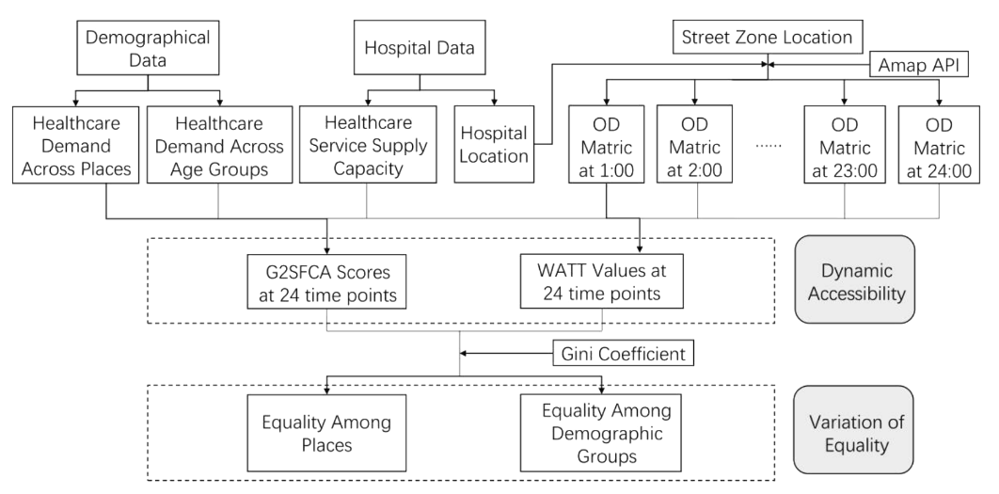

## Results and discussion

[[ go back to the top ]](#Table-of-contents)

### Spatial distribution of crime rate 

`Major Category`

In [ ]:
# 函数封装：用于绘制犯罪率分布图
def plot_crime_rate_by_lsoa(years, major_cat, n_quantiles=7, ncols=4):
    """
    Function to plot crime rate per LSOA for each year.
    
    Parameters:
    merged_cat: GeoDataFrame with merged data (geo data + crime data)
    years: List of years to plot.
    major_cat: Crime category to plot.
    n_quantiles: Number of quantiles to split crime rate distribution.
    ncols: Number of columns for subplot layout.
    """
    filtered_data = df_yearly[df_yearly['Major Category'] == major_cat].copy()

    # 合并地理数据
    merged_cat = UK_LSOA.merge(filtered_data, left_on='lsoa21cd', right_on='LSOA Code', how='left')

    # 计算每个 LSOA 归一化后的犯罪率（基于面积）
    for year in years:
        merged_cat[f'{year}_area'] = merged_cat[str(year)] / merged_cat['area_km2']

    # **计算 LSOA 的占比百分位**（按 LSOA 数量，而非值）
    yearly_columns = merged_cat[[f'{year}_area' for year in years]].stack().dropna()

    # 基于 LSOA 占比计算 cutpoints
    _, bins = pd.qcut(yearly_columns, q=n_quantiles, retbins=True, duplicates="drop")

    # 确保 bins 唯一 & 合理
    unique_cutpoints = np.unique(bins.round(2))
    unique_cutpoints = unique_cutpoints[1:-1]  # 移除 bins[0] = 0.00

    # 创建子图布局
    num_years = len(years)
    nrows = -(-num_years // ncols)  # 向上取整计算行数
    fig, axes = plt.subplots(nrows, ncols, figsize=(ncols * 4, nrows * 4))
    axes = axes.flatten()

    # 遍历年份绘制地图
    for i, year in enumerate(years):
        ax = axes[i]
        year_str = f'{year}_area'  # 选择归一化列

        merged_cat.plot(
            column=year_str, cmap='RdBu_r', linewidth=0, ax=ax,
            legend=True, scheme='user_defined',
            classification_kwds={'bins': unique_cutpoints},
            legend_kwds={'fontsize': 8, 'markerscale': 0.5, 'loc': 'lower right'},  # 调整图例字体大小和标记符号大小
            missing_kwds={'color': 'lightgrey', 'hatch': '///'}  # 渲染 NaN 为灰色并添加斜线
        )

        ax.set_title(f'{major_cat} Rate\n {year}  (count per KM2)', fontsize=10)
        ax.axis('off')

    # 移除多余的空白子图
    for i in range(num_years, len(axes)):
        fig.delaxes(axes[i])

    # 调整子图间距
    plt.subplots_adjust(hspace=0, wspace=0)  # 调整子图之间的垂直和水平间距
    plt.tight_layout()
    plt.show()

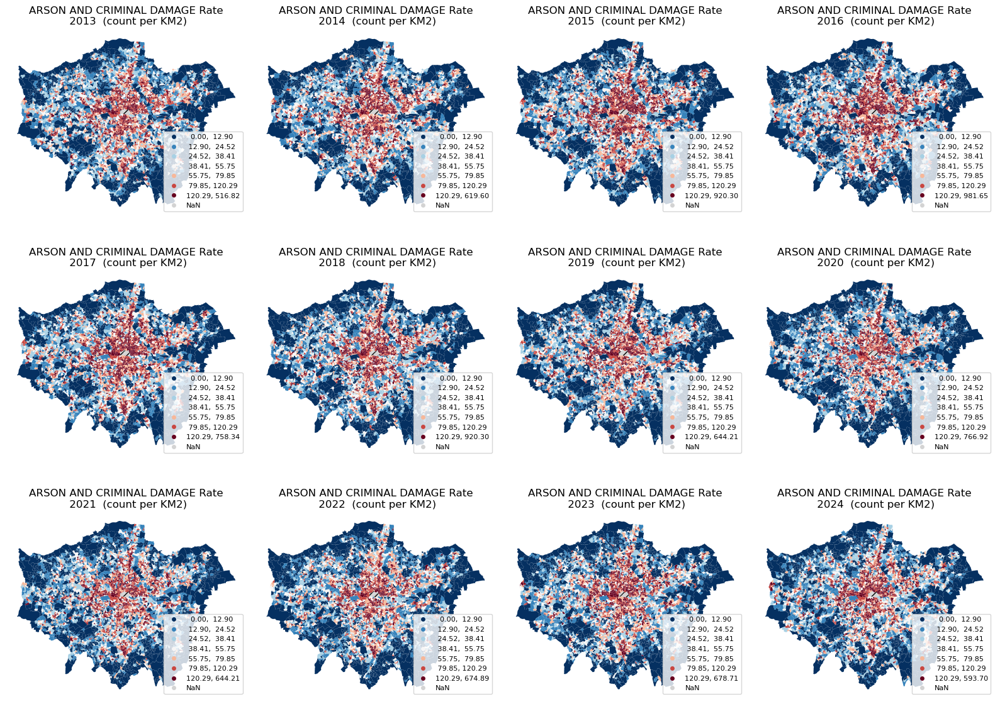

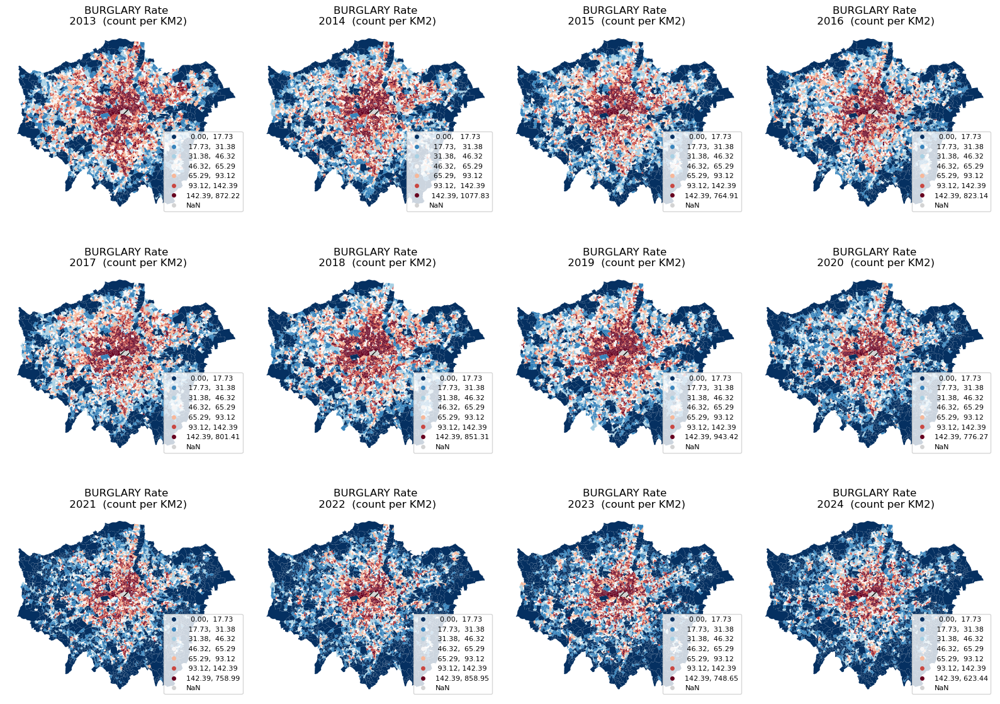

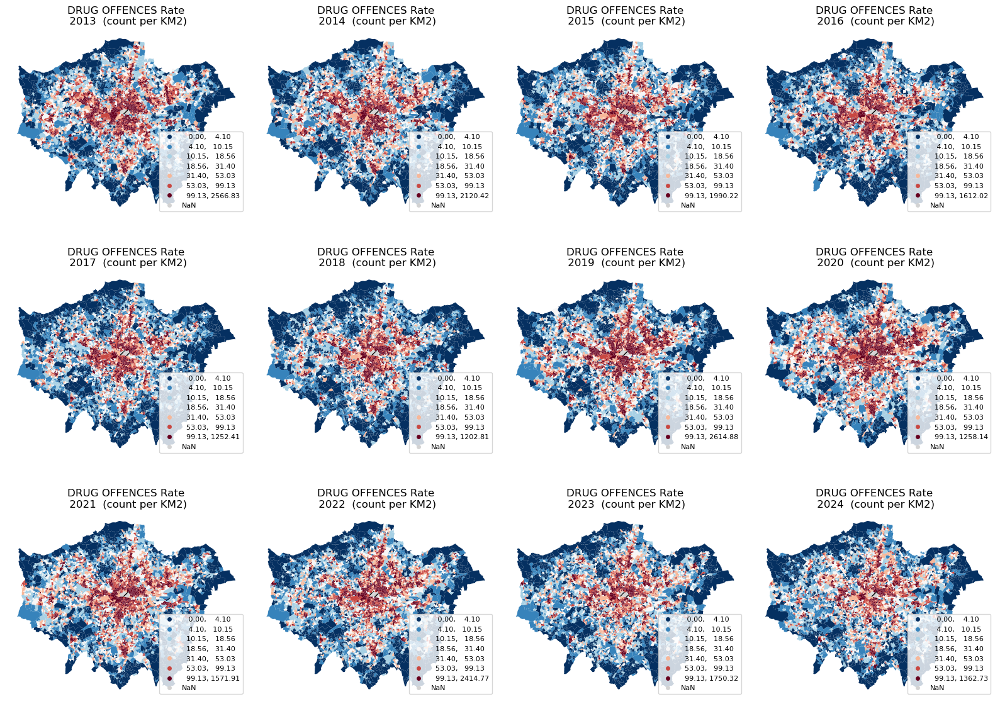

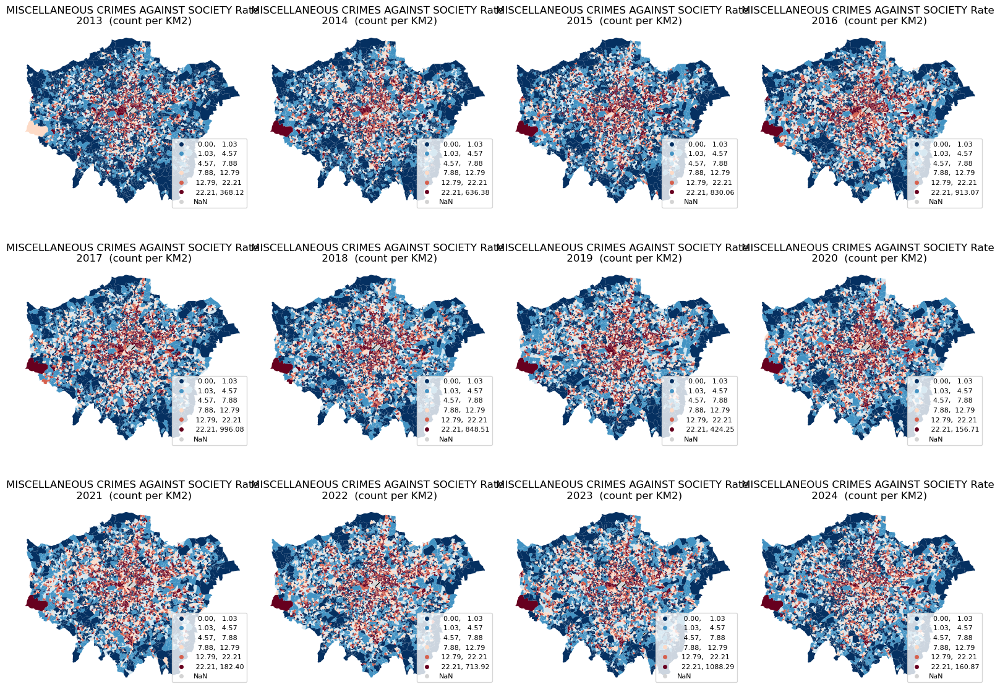

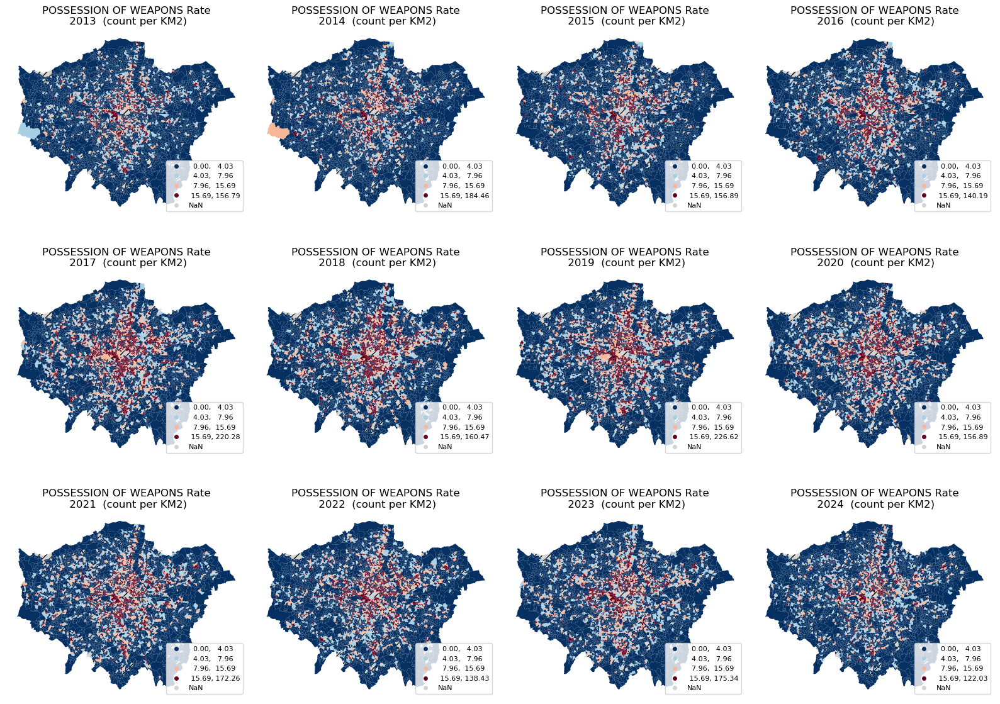

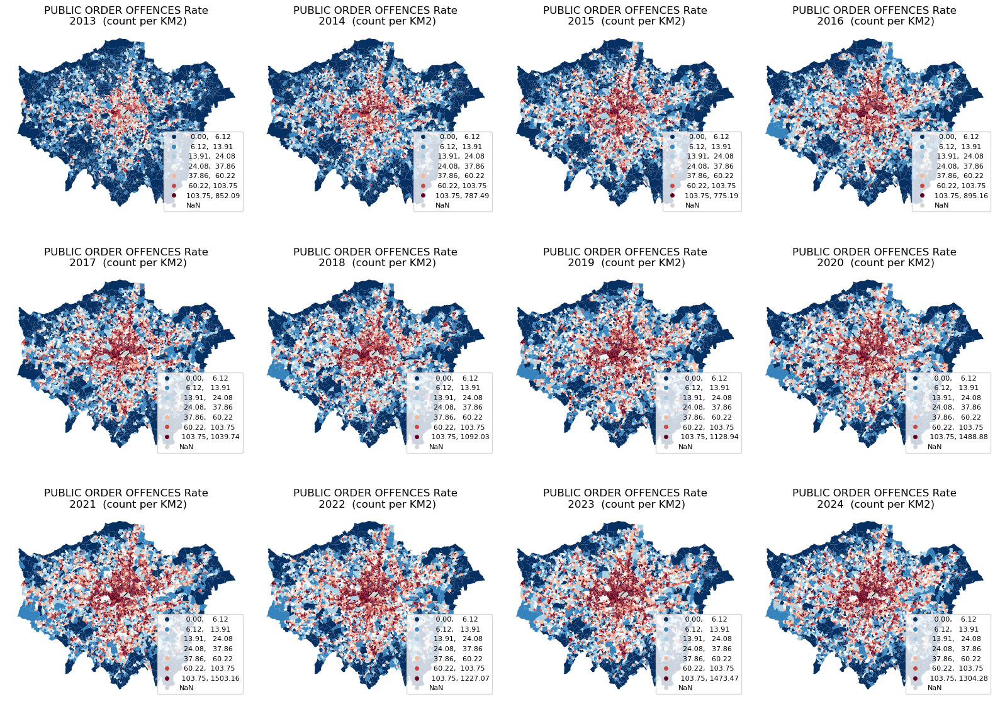

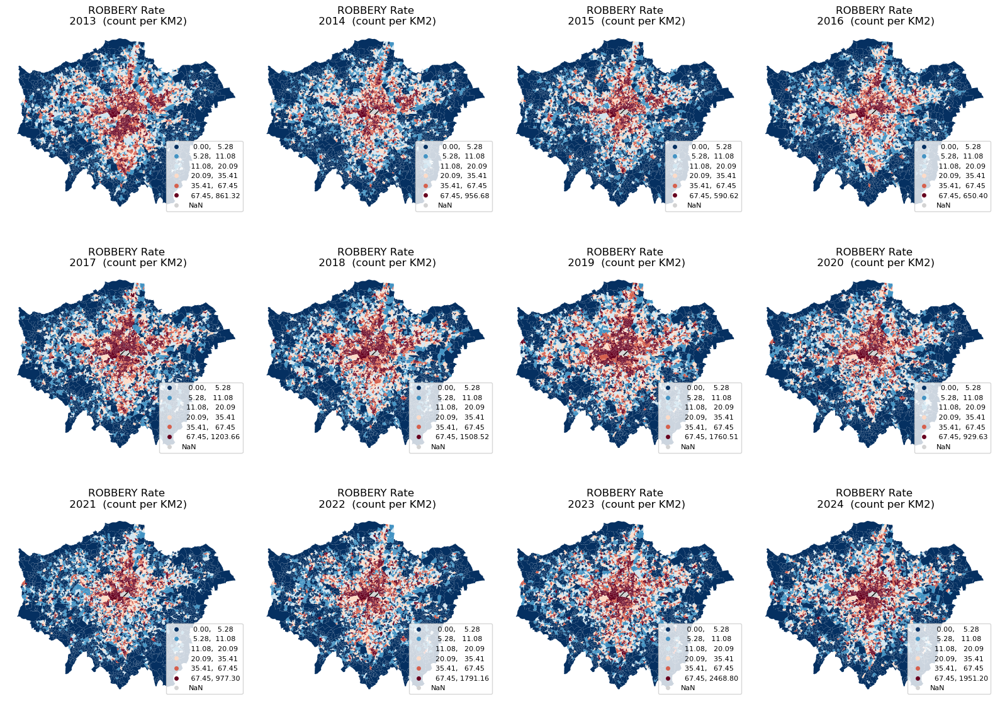

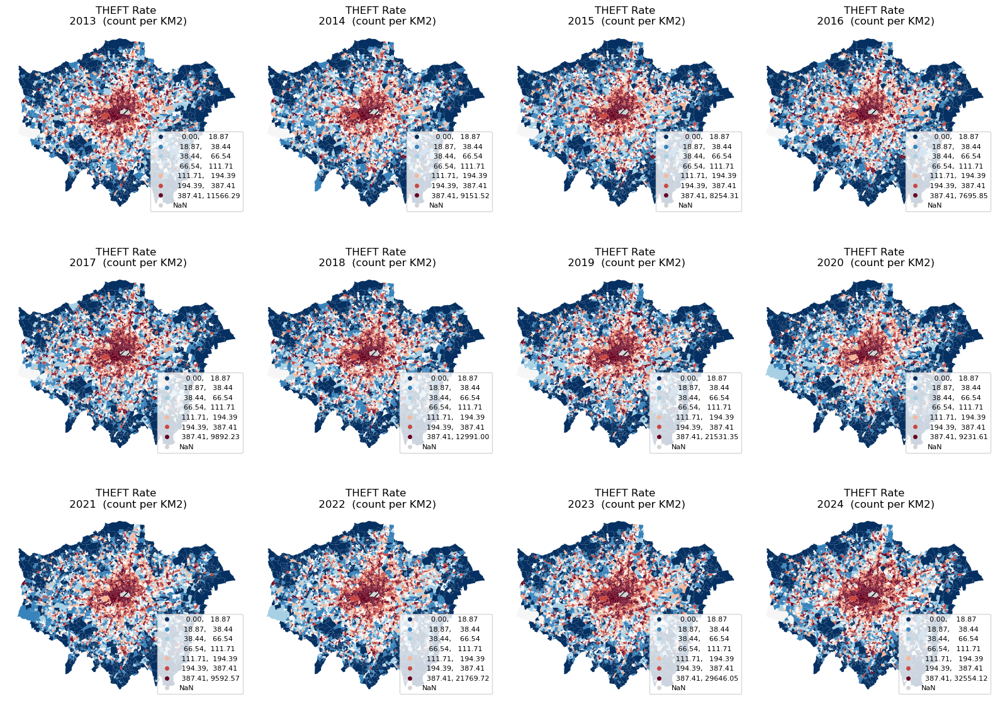

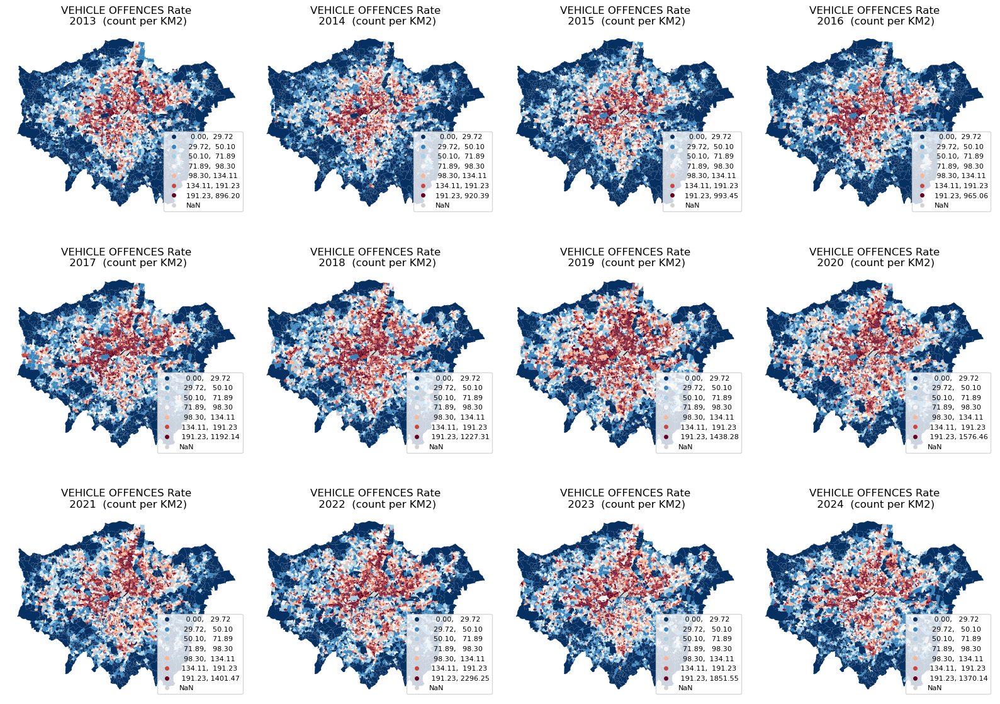

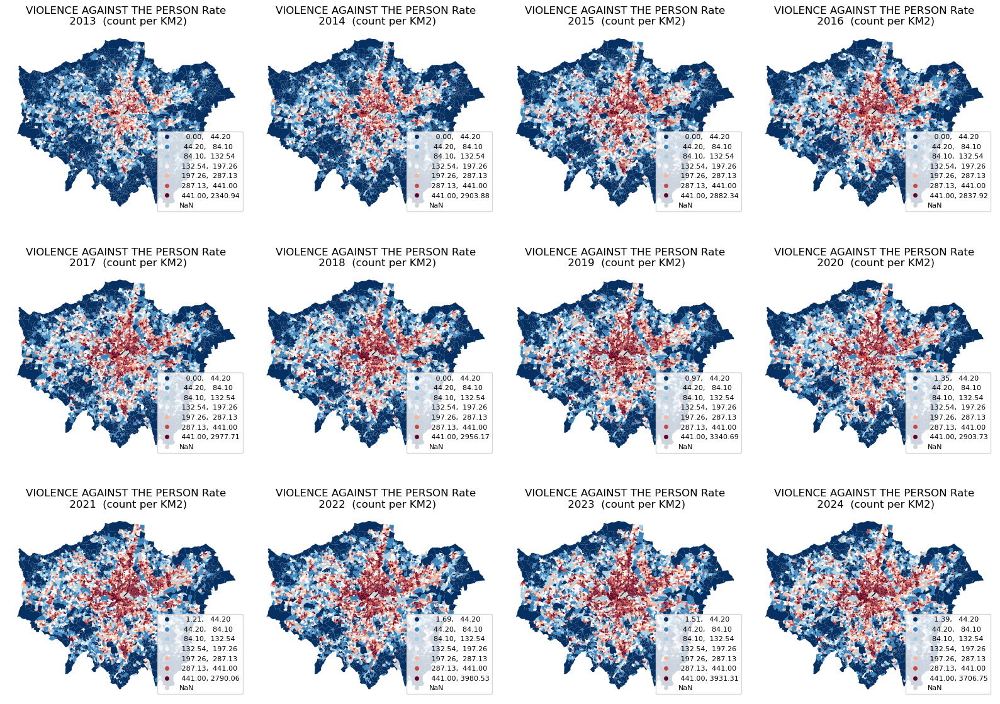

In [7]:
years = ['2013', '2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023', '2024']
major_categories = df_yearly['Major Category'].unique()
for major_cat in major_categories:
  plot_crime_rate_by_lsoa(years, major_cat)

`All crimes`

In [8]:
def for_all_types(lsoa_grouped_yearly, years, n_quantiles=7, ncols=4):
    # 合并地理数据
    merged_cat = UK_LSOA.merge(lsoa_grouped_yearly, left_on='lsoa21cd', right_on='LSOA Code', how='left')

    # 计算每个 LSOA 归一化后的犯罪率（基于面积）
    for year in years:
        merged_cat[f'{year}_area'] = merged_cat[str(year)] / merged_cat['area_km2']

    # **计算 LSOA 的占比百分位**（按 LSOA 数量，而非值）
    yearly_columns = merged_cat[[f'{year}_area' for year in years]].stack()

    # 基于 LSOA 占比计算 cutpoints
    _, bins = pd.qcut(yearly_columns, q=n_quantiles, retbins=True, duplicates="drop")

    # 确保 bins 唯一 & 合理
    unique_cutpoints = np.unique(bins.round(2))
    unique_cutpoints = unique_cutpoints[1:-1]  # 移除 bins[0] = 0.00

    # 创建子图布局
    num_years = len(years)
    nrows = -(-num_years // ncols)  # 向上取整计算行数
    fig, axes = plt.subplots(nrows, ncols, figsize=(ncols * 4, nrows * 4))
    axes = axes.flatten()

    # 遍历年份绘制地图
    for i, year in enumerate(years):
        ax = axes[i]
        year_str = f'{year}_area'  # 选择归一化列

        merged_cat.plot(
            column=year_str, cmap='RdBu_r', linewidth=0, ax=ax,
            legend=True, scheme='user_defined',
            classification_kwds={'bins': unique_cutpoints},
            legend_kwds={'fontsize': 8, 'markerscale': 0.5, 'loc': 'lower right'},  # 调整图例字体大小和标记符号大小
            missing_kwds={'color': 'lightgrey', 'hatch': '///'}  # 渲染 NaN 为灰色并添加斜线
        )

        ax.set_title(f'Total CrimeSum\n in London LSOAs - {year}  (per KM2)', fontsize=12)
        ax.axis('off')

    # 移除多余的空白子图
    for i in range(num_years, len(axes)):
        fig.delaxes(axes[i])

    # 调整子图间距
    plt.subplots_adjust(hspace=0, wspace=0)  # 调整子图之间的垂直和水平间距
    plt.tight_layout()
    plt.show()

In [6]:
# Timeseries of each Major Category. What are trends of each major category like?
drop_list = ['Major Category', 'Borough']
lsoa_grouped_yearly = df_yearly.groupby(by=['LSOA Code']).agg('sum').drop(columns=drop_list)
# 设置 "Major Category" 为索引
lsoa_grouped_yearly

,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,2024
LSOA Code,,,,,,,,,,,,,,
E01000006,107.0,100.0,93.0,73.0,82.0,79.0,95.0,113.0,108.0,103.0,94.0,119.0,87.0,89.0
E01000007,403.0,366.0,312.0,269.0,385.0,370.0,442.0,387.0,519.0,529.0,507.0,473.0,647.0,521.0
E01000008,178.0,130.0,131.0,176.0,196.0,180.0,172.0,194.0,213.0,192.0,224.0,210.0,234.0,135.0
E01000009,337.0,278.0,222.0,234.0,241.0,183.0,189.0,248.0,270.0,292.0,298.0,294.0,376.0,243.0
E01000011,113.0,108.0,81.0,99.0,70.0,108.0,95.0,101.0,91.0,107.0,111.0,103.0,121.0,115.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
E01035718,1436.0,1349.0,1204.0,1096.0,1051.0,1229.0,1199.0,1293.0,1915.0,1040.0,1090.0,1364.0,1636.0,1678.0
E01035719,109.0,65.0,50.0,52.0,76.0,70.0,64.0,70.0,102.0,65.0,55.0,76.0,64.0,93.0
E01035720,86.0,121.0,108.0,89.0,71.0,93.0,113.0,110.0,135.0,97.0,92.0,105.0,83.0,82.0


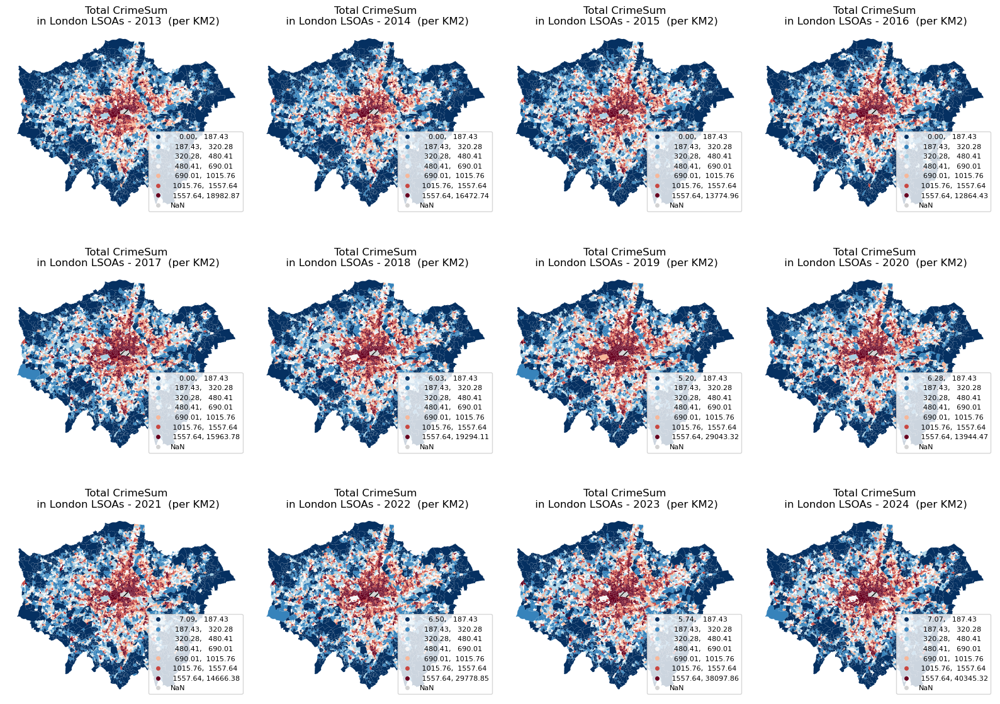

In [10]:
for_all_types(lsoa_grouped_yearly, years)

In [37]:
def calculate_spatial_statistics(major_cat, year, ax):
    """
    计算 Moran's I 和 Getis-Ord G*，并绘制犯罪热点图（在 ax 上）。
    """
    # 筛选数据
    filtered_data = df_yearly[df_yearly['Major Category'] == major_cat].copy()
    merged_cat = UK_LSOA.merge(filtered_data, left_on='lsoa21cd', right_on='LSOA Code', how='left')
    
    # 计算每平方公里犯罪率
    merged_cat[f'{year}_area'] = merged_cat[str(year)] / merged_cat['area_km2']
    
    # 去除 NaN 数据
    merged_cat_no_nan = merged_cat.dropna(subset=[f'{year}_area'])
    w = Queen.from_dataframe(merged_cat_no_nan, use_index=False)  # 显式设置 use_index=False
    w.transform = 'r'

    # 计算 Moran's I
    moran = Moran(merged_cat_no_nan[f'{year}_area'], w)

    # 计算 Getis-Ord G*
    g_star = G_Local(merged_cat_no_nan[f'{year}_area'], w)
    merged_cat.loc[merged_cat_no_nan.index, f'Gi_{year}'] = g_star.Zs  # 插入 Gi 值

    # 设置颜色映射
    bins = [-2.0, -1.6, 0, 1.6, 2.0]
    merged_cat.plot(
        column=f'Gi_{year}', cmap='RdBu_r', linewidth=0.2, ax=ax, legend=True,
        scheme='user_defined', classification_kwds={'bins': bins},
        legend_kwds={
            'title': "Getis-Ord G* Z-score", 'loc': 'lower right', 'bbox_to_anchor': (1.05, 0),
            'fontsize': 8, 'markerscale': 0.5, 'labelspacing': 0.5
        },
        missing_kwds={'color': 'lightgrey', 'hatch': '///'},
    )

    # 设置标题
    ax.set_title(f"{major_cat} - {year}", fontsize=12)
    ax.axis('off')

    # 返回 Moran's I 结果
    return [major_cat, f"{moran.I:.4f}", f"{moran.p_norm:.4f}"]


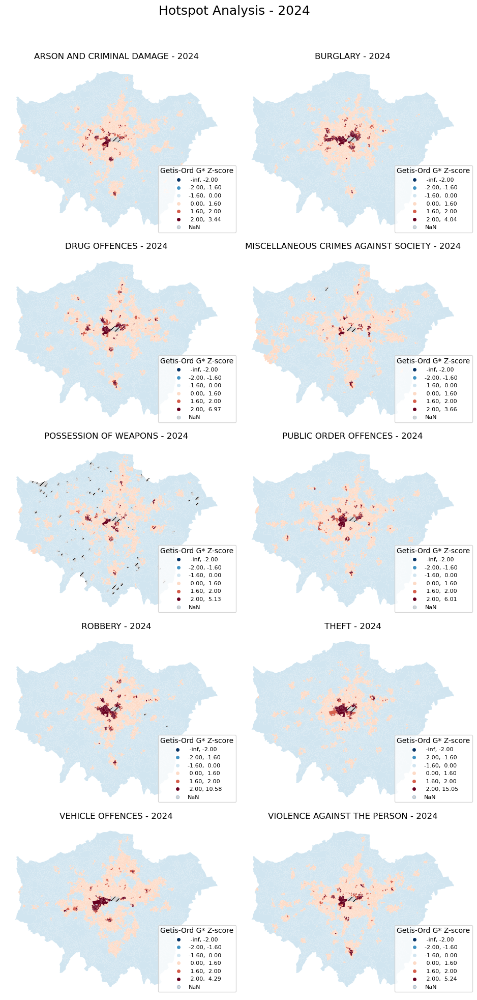


Moran's I Results:
╒══════════════════════════════════════╤═════════════╤═══════════╕
│ Crime Type                           │   Moran's I │   p-value │
╞══════════════════════════════════════╪═════════════╪═══════════╡
│ ARSON AND CRIMINAL DAMAGE            │      0.4206 │         0 │
├──────────────────────────────────────┼─────────────┼───────────┤
│ BURGLARY                             │      0.5232 │         0 │
├──────────────────────────────────────┼─────────────┼───────────┤
│ DRUG OFFENCES                        │      0.4159 │         0 │
├──────────────────────────────────────┼─────────────┼───────────┤
│ MISCELLANEOUS CRIMES AGAINST SOCIETY │      0.2138 │         0 │
├──────────────────────────────────────┼─────────────┼───────────┤
│ POSSESSION OF WEAPONS                │      0.2371 │         0 │
├──────────────────────────────────────┼─────────────┼───────────┤
│ PUBLIC ORDER OFFENCES                │      0.3758 │         0 │
├──────────────────────────────────────┼──

In [41]:
# 选择要分析的年份
year_to_analyze = 2024
major_categories = df_yearly['Major Category'].unique()

# 创建子图（5行2列）
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(10, 20))
fig.suptitle(f"Hotspot Analysis - {year_to_analyze}", fontsize=18)

# 统计结果表
results = []

# 遍历类别，计算统计量并绘制地图
for i, major_cat in enumerate(major_categories[:10]):  # 处理前10个犯罪类别
    row, col = divmod(i, 2)
    result = calculate_spatial_statistics(major_cat, year_to_analyze, axes[row, col])
    results.append(result)

# 删除多余的空白子图
for i in range(len(major_categories), 10):
    fig.delaxes(axes.flatten()[i])

# **优化子图间距**
plt.subplots_adjust(hspace=0.3, wspace=0)  # 让子图更紧凑

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 打印 Moran's I 结果
print("\nMoran's I Results:")
print(tabulate(results, headers=["Crime Type", "Moran's I", "p-value"], tablefmt="fancy_grid"))

Total Crime - 2024
Moran's I: 0.5040, p-value: 0.0000


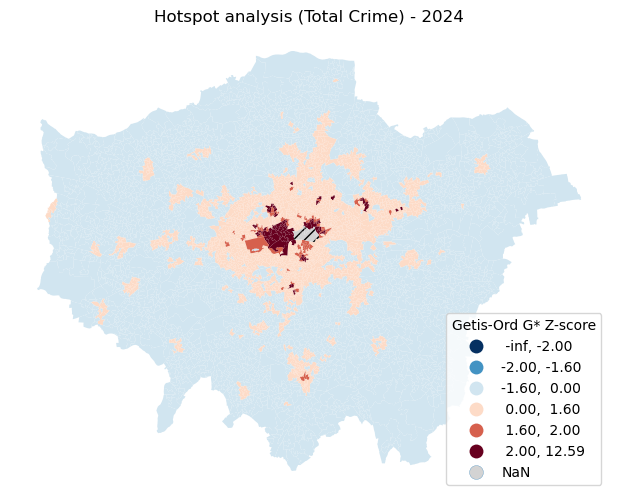

In [13]:
# 使用 left 合并，保留所有数据
merged_cat = UK_LSOA.merge(lsoa_grouped_yearly, left_on='lsoa21cd', right_on='LSOA Code', how='left')

year = 2024

# 计算每个区域的犯罪率（按每平方千米面积计算）
merged_cat[f'{year}_area'] = merged_cat[str(year)] / merged_cat['area_km2']

# 计算 Moran's I 时去除 NaN 数据
merged_cat_no_nan = merged_cat.dropna(subset=[f'{year}_area'])  # 去掉含 NaN 的区域
w = Queen.from_dataframe(merged_cat_no_nan, use_index=False)  # 用没有 NaN 的数据来构建权重矩阵
w.transform = 'r'

# 计算 Moran's I
moran = Moran(merged_cat_no_nan[f'{year}_area'], w)
print(f"Total Crime - {year}")
print(f"Moran's I: {moran.I:.4f}, p-value: {moran.p_norm:.4f}")

# 计算 Getis-Ord G* 热点分析
g_star = G_Local(merged_cat_no_nan[f'{year}_area'], w)
merged_cat.loc[merged_cat_no_nan.index, f'Gi_{year}'] = g_star.Zs  # 保留原数据，插入 Gi 值

# 自定义分类区间并绘制图形
bins = [-2.0, -1.6, 0, 1.6, 2.0]  # 自定义分类区间

# 绘制地图
fig, ax = plt.subplots(figsize=(9, 6))
merged_cat.plot(
  column=f'Gi_{year}', cmap='RdBu_r', linewidth=0.2, ax=ax, legend=True,
  scheme='user_defined', classification_kwds={'bins': bins},
  legend_kwds={'title': "Getis-Ord G* Z-score", 'loc': 'lower right'},
  missing_kwds={'color': 'lightgrey', 'hatch': '///'}  # 渲染 NaN 为灰色并添加斜线
)

# 添加标题和移除坐标轴
ax.set_title(f"Hotspot analysis (Total Crime) - {year}", fontsize=12)
ax.axis('off')

# 显示图形
plt.show()

### Cluster analysis

In [14]:
crime24 = df_yearly[["LSOA Code", "Major Category", "2024"]]
crime24 

,LSOA Code,Major Category,2024
0,E01000006,ARSON AND CRIMINAL DAMAGE,5.0
1,E01000006,BURGLARY,2.0
2,E01000006,DRUG OFFENCES,3.0
3,E01000006,MISCELLANEOUS CRIMES AGAINST SOCIETY,2.0
4,E01000006,POSSESSION OF WEAPONS,2.0
...,...,...,...
49782,E01035722,PUBLIC ORDER OFFENCES,13.0
49783,E01035722,ROBBERY,6.0
49784,E01035722,THEFT,47.0
49785,E01035722,VEHICLE OFFENCES,6.0


In [15]:
crime24 = crime24.pivot_table(index= 'LSOA Code', columns = 'Major Category', 
                                    values = "2024", fill_value = 0).reset_index()
#then rename the axis
crime24.rename_axis(None, axis=1, inplace=True)
crime24

,LSOA Code,ARSON AND CRIMINAL DAMAGE,BURGLARY,DRUG OFFENCES,MISCELLANEOUS CRIMES AGAINST SOCIETY,POSSESSION OF WEAPONS,PUBLIC ORDER OFFENCES,ROBBERY,THEFT,VEHICLE OFFENCES,VIOLENCE AGAINST THE PERSON
0,E01000006,5.0,2.0,3.0,2.0,2.0,6.0,6.0,13.0,21.0,29.0
1,E01000007,32.0,22.0,63.0,2.0,4.0,42.0,46.0,138.0,16.0,156.0
2,E01000008,10.0,4.0,6.0,0.0,0.0,7.0,6.0,19.0,22.0,61.0
3,E01000009,24.0,12.0,15.0,3.0,2.0,12.0,14.0,58.0,22.0,81.0
4,E01000011,11.0,5.0,8.0,4.0,0.0,5.0,5.0,15.0,8.0,54.0
...,...,...,...,...,...,...,...,...,...,...,...
4983,E01035718,62.0,23.0,98.0,4.0,7.0,95.0,84.0,861.0,203.0,241.0
4984,E01035719,6.0,2.0,4.0,0.0,0.0,7.0,6.0,33.0,3.0,32.0
4985,E01035720,3.0,5.0,1.0,1.0,1.0,7.0,3.0,30.0,8.0,23.0
4986,E01035721,32.0,22.0,11.0,3.0,1.0,26.0,25.0,328.0,23.0,115.0


In [16]:
#extract the columns to sum
cols_to_sum = [col for col in crime24.columns if "LSOA" not in col]
#sum across the columns rather than rows
crime24['Total_crime'] = 0
#sum across the columns rather than rows
crime24["Total_crime"] = crime24[cols_to_sum].sum(axis=1)
crime24

,LSOA Code,ARSON AND CRIMINAL DAMAGE,BURGLARY,DRUG OFFENCES,MISCELLANEOUS CRIMES AGAINST SOCIETY,POSSESSION OF WEAPONS,PUBLIC ORDER OFFENCES,ROBBERY,THEFT,VEHICLE OFFENCES,VIOLENCE AGAINST THE PERSON,Total_crime
0,E01000006,5.0,2.0,3.0,2.0,2.0,6.0,6.0,13.0,21.0,29.0,89.0
1,E01000007,32.0,22.0,63.0,2.0,4.0,42.0,46.0,138.0,16.0,156.0,521.0
2,E01000008,10.0,4.0,6.0,0.0,0.0,7.0,6.0,19.0,22.0,61.0,135.0
3,E01000009,24.0,12.0,15.0,3.0,2.0,12.0,14.0,58.0,22.0,81.0,243.0
4,E01000011,11.0,5.0,8.0,4.0,0.0,5.0,5.0,15.0,8.0,54.0,115.0
...,...,...,...,...,...,...,...,...,...,...,...,...
4983,E01035718,62.0,23.0,98.0,4.0,7.0,95.0,84.0,861.0,203.0,241.0,1678.0
4984,E01035719,6.0,2.0,4.0,0.0,0.0,7.0,6.0,33.0,3.0,32.0,93.0
4985,E01035720,3.0,5.0,1.0,1.0,1.0,7.0,3.0,30.0,8.0,23.0,82.0
4986,E01035721,32.0,22.0,11.0,3.0,1.0,26.0,25.0,328.0,23.0,115.0,586.0


In [17]:
#we then want to turn the previous columns into percentages
#do this by dividing over the total crime columns
for col in cols_to_sum:
    crime24[col] = (crime24[col] / crime24["Total_crime"]).round(4)
crime24

,LSOA Code,ARSON AND CRIMINAL DAMAGE,BURGLARY,DRUG OFFENCES,MISCELLANEOUS CRIMES AGAINST SOCIETY,POSSESSION OF WEAPONS,PUBLIC ORDER OFFENCES,ROBBERY,THEFT,VEHICLE OFFENCES,VIOLENCE AGAINST THE PERSON,Total_crime
0,E01000006,0.0562,0.0225,0.0337,0.0225,0.0225,0.0674,0.0674,0.1461,0.2360,0.3258,89.0
1,E01000007,0.0614,0.0422,0.1209,0.0038,0.0077,0.0806,0.0883,0.2649,0.0307,0.2994,521.0
2,E01000008,0.0741,0.0296,0.0444,0.0000,0.0000,0.0519,0.0444,0.1407,0.1630,0.4519,135.0
3,E01000009,0.0988,0.0494,0.0617,0.0123,0.0082,0.0494,0.0576,0.2387,0.0905,0.3333,243.0
4,E01000011,0.0957,0.0435,0.0696,0.0348,0.0000,0.0435,0.0435,0.1304,0.0696,0.4696,115.0
...,...,...,...,...,...,...,...,...,...,...,...,...
4983,E01035718,0.0369,0.0137,0.0584,0.0024,0.0042,0.0566,0.0501,0.5131,0.1210,0.1436,1678.0
4984,E01035719,0.0645,0.0215,0.0430,0.0000,0.0000,0.0753,0.0645,0.3548,0.0323,0.3441,93.0
4985,E01035720,0.0366,0.0610,0.0122,0.0122,0.0122,0.0854,0.0366,0.3659,0.0976,0.2805,82.0
4986,E01035721,0.0546,0.0375,0.0188,0.0051,0.0017,0.0444,0.0427,0.5597,0.0392,0.1962,586.0


In [18]:
london_crime24 = UK_LSOA.merge(crime24, left_on="lsoa21cd", right_on="LSOA Code", how="right").drop(columns='LSOA Code')
# 计算每个区域的面积，单位为平方公里
london_crime24['crime_per_km2'] = london_crime24['Total_crime'] / london_crime24['area_km2']
london_crime24.head()


,lsoa21cd,lsoa21nm,geometry,area_km2,ARSON AND CRIMINAL DAMAGE,BURGLARY,DRUG OFFENCES,MISCELLANEOUS CRIMES AGAINST SOCIETY,POSSESSION OF WEAPONS,PUBLIC ORDER OFFENCES,ROBBERY,THEFT,VEHICLE OFFENCES,VIOLENCE AGAINST THE PERSON,Total_crime,crime_per_km2
0,E01000006,Barking and Dagenham 016A,"POLYGON ((545126.852 184310.838, 545145.213 18...",0.146537,0.0562,0.0225,0.0337,0.0225,0.0225,0.0674,0.0674,0.1461,0.2360,0.3258,89.0,607.355157
1,E01000007,Barking and Dagenham 015A,"POLYGON ((544173.015 184701.354, 544180.164 18...",0.200094,0.0614,0.0422,0.1209,0.0038,0.0077,0.0806,0.0883,0.2649,0.0307,0.2994,521.0,2603.776320
2,E01000008,Barking and Dagenham 015B,"POLYGON ((543570.116 184563.91, 543581.835 184...",0.216901,0.0741,0.0296,0.0444,0.0000,0.0000,0.0519,0.0444,0.1407,0.1630,0.4519,135.0,622.402640
3,E01000009,Barking and Dagenham 016B,"POLYGON ((544602.706 184628.237, 544605.228 18...",0.127960,0.0988,0.0494,0.0617,0.0123,0.0082,0.0494,0.0576,0.2387,0.0905,0.3333,243.0,1899.032024
4,E01000011,Barking and Dagenham 016C,"POLYGON ((544607.954 184727.846, 544620.667 18...",0.091632,0.0957,0.0435,0.0696,0.0348,0.0000,0.0435,0.0435,0.1304,0.0696,0.4696,115.0,1255.016224


In [19]:
def plot_dendrogram(model, **kwargs):
    
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count +=1
            else:
                current_count += counts[child_idx-n_samples]
        counts[i] = current_count
        
    linkage_matrix = np.column_stack([model.children_, model.distances_,
                                    counts]).astype(float)
    
    dendrogram(linkage_matrix, **kwargs)

In [20]:
crime_clus = london_crime24[cols_to_sum]

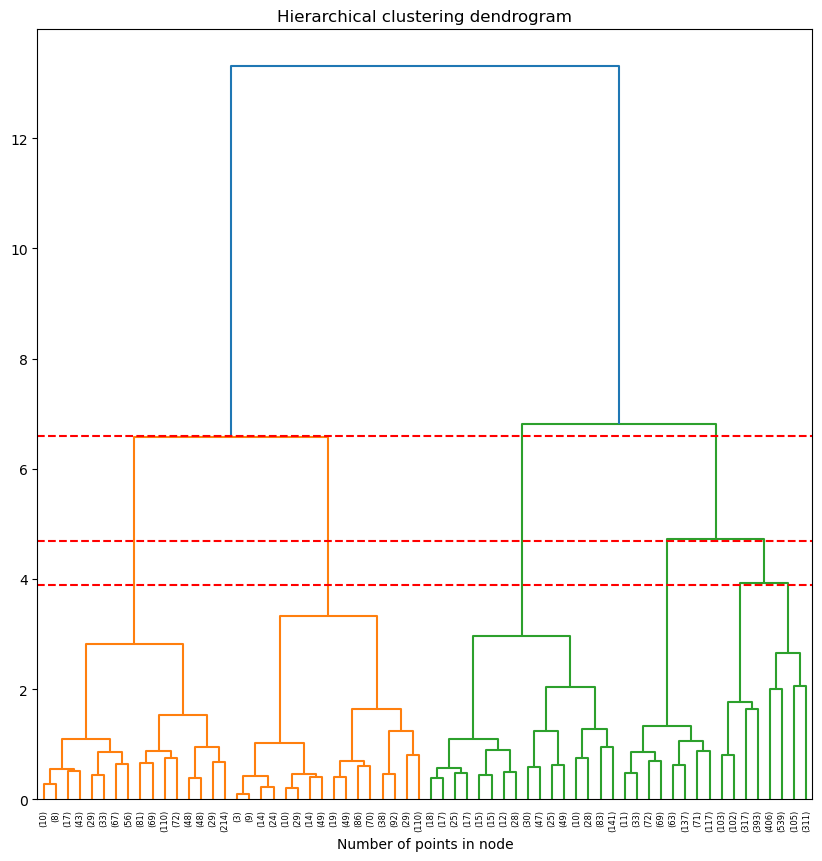

In [21]:
agg_cluster = AgglomerativeClustering(distance_threshold=0, n_clusters=None).fit(crime_clus)

fig, ax = plt.subplots(figsize = (10,10))
ax.set_title("Hierarchical clustering dendrogram")
#plot the top three levels of the dendrogram
plot_dendrogram(agg_cluster, truncate_mode='level', p=5)
plt.axhline(y = 3.9, color = "r", linestyle = "--")
plt.axhline(y = 4.7, color = "r", linestyle = "--")
plt.axhline(y = 6.6, color = "r", linestyle = "--")
ax.set_xlabel("Number of points in node")
plt.show()

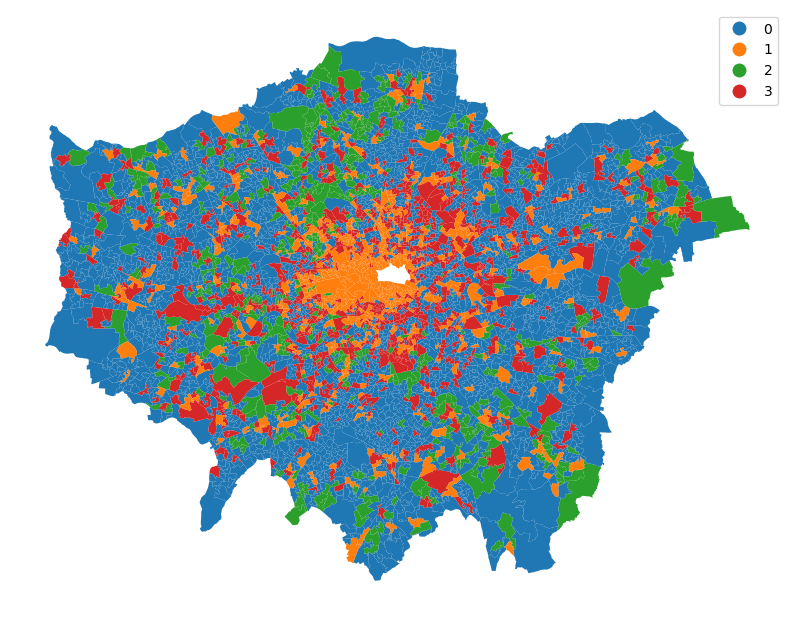

In [48]:
agg_cluster_6 = AgglomerativeClustering(linkage="ward", distance_threshold = 6, n_clusters=None)
agg_cluster_6.fit(crime_clus)

#将聚类结果添加到原数据集
london_crime24["Aggl_clus"] = agg_cluster_6.labels_

# 定义自定义颜色列表（数量需要 ≥ 聚类数）
custom_colors = ["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728"]

# 创建自定义 colormap
cmap = ListedColormap(custom_colors[:london_crime24["Aggl_clus"].nunique()])

fig, ax = plt.subplots(figsize = (10,10))

london_crime24.plot(column = "Aggl_clus", categorical = True, legend=True, cmap=cmap, ax=ax)

ax.set_axis_off()


In [73]:
agglom_means =london_crime24.groupby("Aggl_clus")[cols_to_sum].mean()
agglom_means

,ARSON AND CRIMINAL DAMAGE,BURGLARY,DRUG OFFENCES,MISCELLANEOUS CRIMES AGAINST SOCIETY,POSSESSION OF WEAPONS,PUBLIC ORDER OFFENCES,ROBBERY,THEFT,VEHICLE OFFENCES,VIOLENCE AGAINST THE PERSON
Aggl_clus,,,,,,,,,,
0,0.089161,0.072024,0.052964,0.015514,0.006208,0.065615,0.027413,0.141143,0.160058,0.369894
1,0.045738,0.056090,0.031443,0.006310,0.004086,0.055368,0.044585,0.512533,0.066545,0.177303
2,0.077237,0.137811,0.035239,0.012672,0.003406,0.047817,0.021757,0.147417,0.302309,0.214333
3,0.066313,0.071007,0.045404,0.010138,0.005513,0.071195,0.043453,0.300252,0.125580,0.261142


In [74]:
# DataFrame 转置（即行列互换），然后对所有数值保留三位小数。
agglom_means_T = agglom_means.T.round(3)
#agglom_means_T.reset_index(inplace=True)
agglom_means_T = pd.DataFrame(agglom_means_T)
agglom_means_T

Aggl_clus,0,1,2,3
ARSON AND CRIMINAL DAMAGE,0.089,0.046,0.077,0.066
BURGLARY,0.072,0.056,0.138,0.071
DRUG OFFENCES,0.053,0.031,0.035,0.045
MISCELLANEOUS CRIMES AGAINST SOCIETY,0.016,0.006,0.013,0.010
POSSESSION OF WEAPONS,0.006,0.004,0.003,0.006
PUBLIC ORDER OFFENCES,0.066,0.055,0.048,0.071
ROBBERY,0.027,0.045,0.022,0.043
THEFT,0.141,0.513,0.147,0.300
VEHICLE OFFENCES,0.160,0.067,0.302,0.126
VIOLENCE AGAINST THE PERSON,0.370,0.177,0.214,0.261


C:\Users\YU\AppData\Local\Temp\ipykernel_124\3814252062.py:16: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(labels =agglom_means_T["index"], rotation = 90)
C:\Users\YU\AppData\Local\Temp\ipykernel_124\3814252062.py:16: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(labels =agglom_means_T["index"], rotation = 90)
C:\Users\YU\AppData\Local\Temp\ipykernel_124\3814252062.py:16: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(labels =agglom_means_T["index"], rotation = 90)
C:\Users\YU\AppData\Local\Temp\ipykernel_124\3814252062.py:16: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(labels =

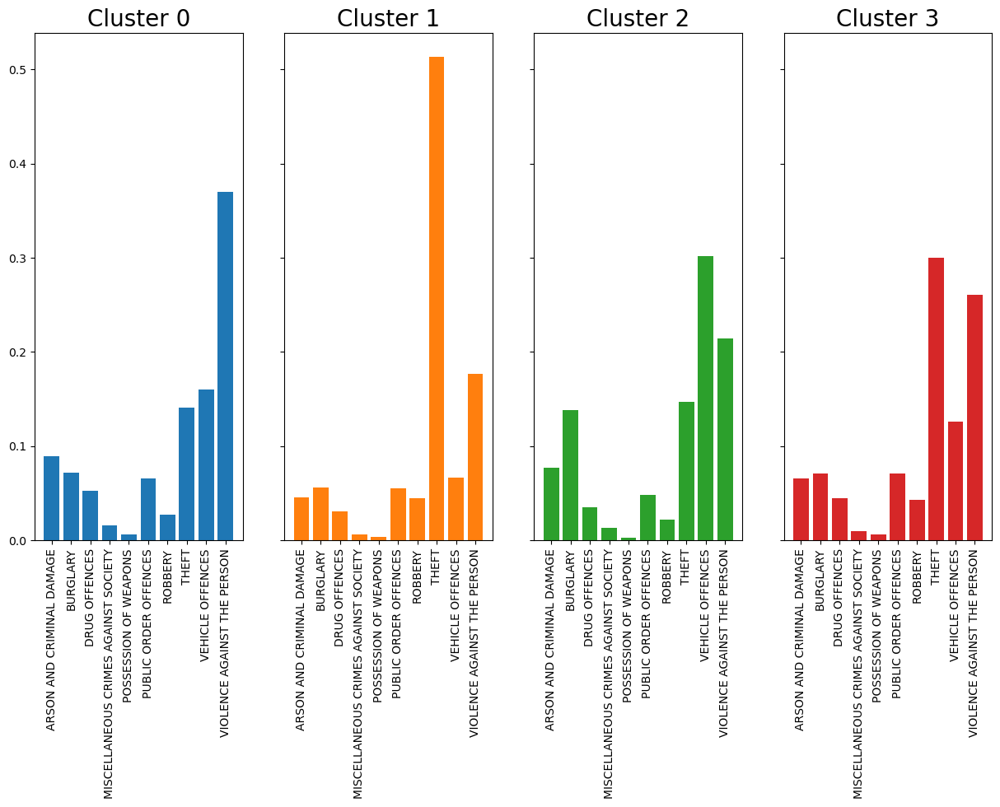

In [57]:
agglom_means_T.reset_index(inplace=True)

#create subplots for each cluster
fig, ax = plt.subplots(1,4, figsize = (15,8), sharey = True, sharex = True)
#flatten the axis
axis = ax.flatten()

#going over each column
for i, col  in enumerate(agglom_means_T.columns):
    #ignore the index column
    if col != "index":
        ax = axis[i-1]
        #plot the bar chart
        ax.bar(height = agglom_means_T[col], x=agglom_means_T["index"], color = custom_colors[i-1] )
        #rotate the x-ticks
        ax.set_xticklabels(labels =agglom_means_T["index"], rotation = 90)
        #set the title
        ax.set_title(f"Cluster {col}", fontsize = 20)

Text(0.5, 1.0, 'Clusters with distance threshold 3')

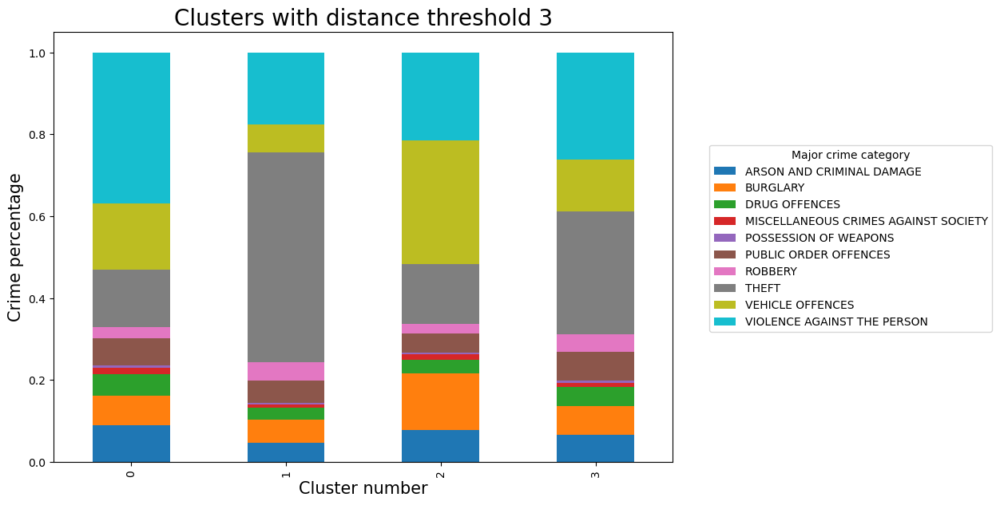

In [ ]:
fig, ax = plt.subplots(figsize = (10,10))

agglom_plot = agglom_means_T.T.plot.bar(stacked=True, figsize=(10,7), ax=ax)
agglom_plot.legend(title='Major crime category', bbox_to_anchor=(1.05, 0.75), loc='upper left')
ax.set_xlabel("Cluster number", fontsize = 15)
ax.set_ylabel("Crime percentage", fontsize = 15)
ax.set_title("Clusters with distance threshold 6", fontsize = 20)

In [27]:
agglom_sizes = london_crime24.groupby("Aggl_clus").size()
agglom_sizes

Aggl_clus
0    2849
1     645
2     560
3     934
dtype: int64

In [28]:
# 计算每个聚类的均值、标准差、中位数
group_stats = london_crime24.groupby("Aggl_clus")["crime_per_km2"].describe()
print(group_stats)

            count         mean          std        min          25%  \
Aggl_clus                                                             
0          2849.0   650.189976   552.742339   7.249097   269.778784   
1           645.0  2717.506992  3004.263095  58.007982  1058.229036   
2           560.0   360.048403   386.789302   7.068130   127.011720   
3           934.0  1152.724561   857.860258  26.104472   524.342930   

                   50%          75%           max  
Aggl_clus                                          
0           493.741673   872.159904   5307.069805  
1          1939.007822  3588.029570  40345.318556  
2           230.158658   453.634782   3749.758516  
3           973.747903  1527.799086   6023.348331  


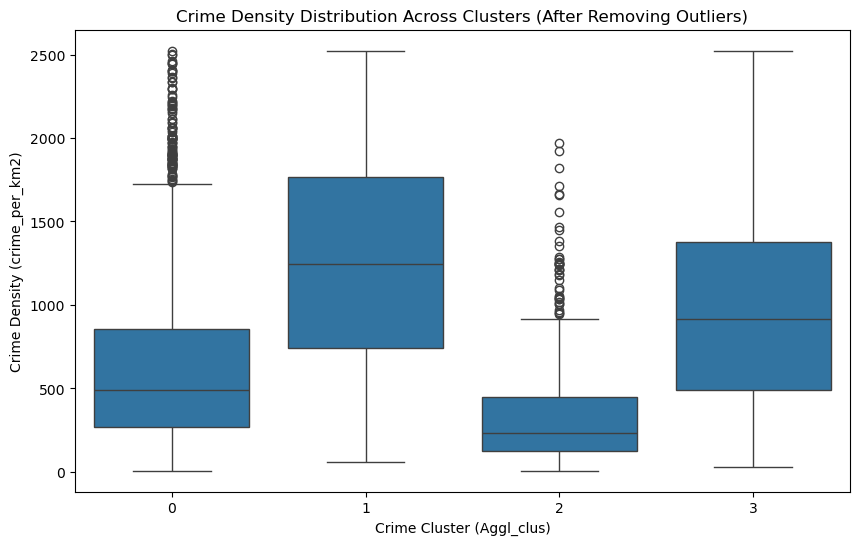

In [29]:
Q1 = london_crime24['crime_per_km2'].quantile(0.25)
Q3 = london_crime24['crime_per_km2'].quantile(0.75)
IQR = Q3 - Q1

filtered_data = london_crime24[
    (london_crime24['crime_per_km2'] >= (Q1 - 1.5 * IQR)) & (london_crime24['crime_per_km2'] <= (Q3 + 1.5 * IQR))
]

plt.figure(figsize=(10, 6))
sns.boxplot(x="Aggl_clus", y="crime_per_km2", data=filtered_data)
plt.xlabel("Crime Cluster (Aggl_clus)")
plt.ylabel("Crime Density (crime_per_km2)")
plt.title("Crime Density Distribution Across Clusters (After Removing Outliers)")
plt.show()


In [30]:
london_crime24["crime_per_km2"].describe()

count     4988.000000
mean       979.040717
std       1412.728502
min          7.068130
25%        292.847937
50%        600.520514
75%       1186.393649
max      40345.318556
Name: crime_per_km2, dtype: float64

In [31]:
# 将`crime_per_km2`划分为类别
quantiles = london_crime24['crime_per_km2'].quantile([0, 0.2, 0.4, 0.6, 0.8, 1.0])
bins = quantiles.values
labels = ['Very Low', 'Low', 'Medium-Low', 'Medium-High', 'High']
london_crime24['crime_density_category'] = pd.cut(london_crime24['crime_per_km2'], bins=bins, labels=labels, include_lowest=True)


# 卡方检验
contingency_table = pd.crosstab(london_crime24['Aggl_clus'], london_crime24['crime_density_category'])
chi2, p, _, _ = chi2_contingency(contingency_table)
print("Chi-Square p-value:", p)
print("Chi-Square Statistic:", chi2)
print("Degrees of Freedom:", len(contingency_table) - 1)
print("Contingency Table:\n", contingency_table)


Chi-Square p-value: 0.0
Chi-Square Statistic: 1753.8768711856894
Degrees of Freedom: 3
Contingency Table:
 crime_density_category  Very Low  Low  Medium-Low  Medium-High  High
Aggl_clus                                                           
0                            608  710         700          562   269
1                             22   26          62          105   430
2                            291  135          72           50    12
3                             77  126         164          280   287


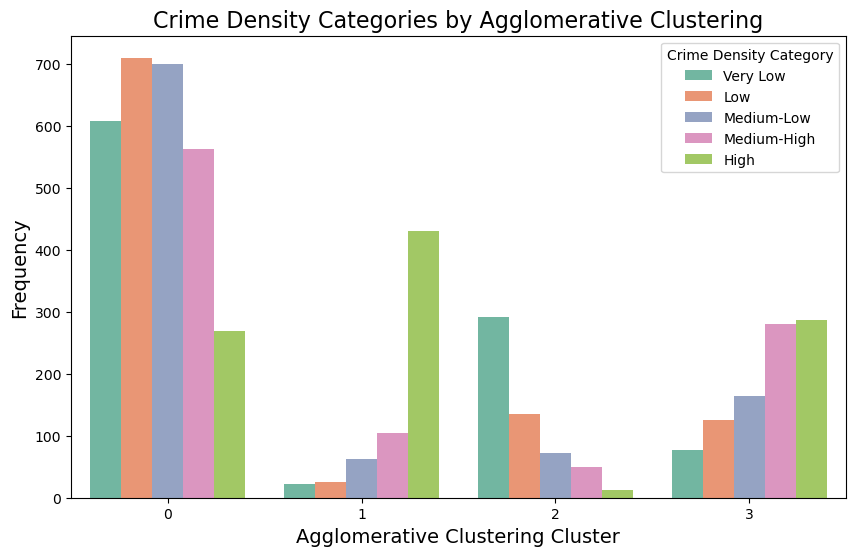

In [32]:
# 设置图形大小
plt.figure(figsize=(10, 6))

# 画条形图
sns.countplot(data=london_crime24, x='Aggl_clus', hue='crime_density_category', palette='Set2')

# 设置标题和标签
plt.title('Crime Density Categories by Agglomerative Clustering', fontsize=16)
plt.xlabel('Agglomerative Clustering Cluster', fontsize=14)
plt.ylabel('Frequency', fontsize=14)
plt.legend(title='Crime Density Category', loc='upper right')

plt.show()

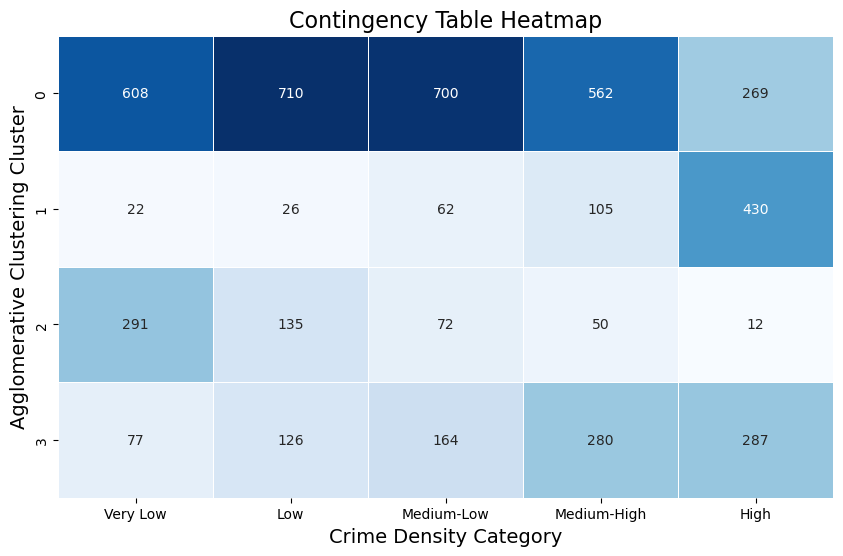

In [33]:
import seaborn as sns
import matplotlib.pyplot as plt

# 创建热力图
plt.figure(figsize=(10, 6))
sns.heatmap(contingency_table, annot=True, fmt='d', cmap='Blues', cbar=False, linewidths=0.5)

# 设置标题和标签
plt.title('Contingency Table Heatmap', fontsize=16)
plt.xlabel('Crime Density Category', fontsize=14)
plt.ylabel('Agglomerative Clustering Cluster', fontsize=14)

plt.show()


## Conclusion

[[ go back to the top ]](#Table-of-contents)

## References

[[ go back to the top ]](#Table-of-contents)